In [1]:
from __future__ import print_function
import mdtraj as md
import numpy as np
import matplotlib.pyplot as plt
import pandas
from collections import defaultdict
import random
import scipy.cluster.hierarchy
from scipy.spatial.distance import squareform
from matplotlib import *


rc('text', usetex=True)
rc('font',**{'family':'serif','serif':['Computer Modern']})
rc('text.latex',preamble=r'\usepackage{times}')
rc('text.latex',preamble=r'\usepackage{amsmath}')
#rc('text.latex',preamble=r'\usepackage{boldmath}')
#rc(['text.latex.preamble'] = [r'\boldmath']
plt.rcParams.update({'font.size': 10})
plt.rcParams['xtick.major.pad'] = 8
plt.rcParams['ytick.major.pad'] = 8

In [3]:
with open("distance_matrix.dat") as textFile:
        s = [line.split() for line in textFile]
data = np.memmap('distance_matrix.dat',dtype=np.float32,shape=(9751,9751))
reduced_distances = squareform(data, checks=False)

FileNotFoundError: [Errno 2] No such file or directory: 'distance_matrix.dat'

In [20]:
fname = 'distance_matrix.dat'
def load_big_file(fname):
    '''only works for well-formed text file of space-separated doubles'''

    rows = []  # unknown number of lines, so use list
    with open(fname) as f:
        for line in f:
            line = [float(s) for s in line.split()]
            rows.append(np.array(line, dtype = np.double))
    return np.vstack(rows)  # convert list of vectors to array
s=np.vstack(rows)

NameError: name 'rows' is not defined

In [2]:
nrow=19502
ncol=19502
fname='distance_matrix.dat'
def load_known_size(fname, nrow, ncol):
    x = np.empty((nrow, ncol), dtype = np.double)
    with open(fname) as f:
        for irow, line in enumerate(f):
            for icol, s in enumerate(line.split()):
                x[irow, icol] = float(s)
    return x
y=load_known_size(fname,nrow,ncol)
#reduced_distances = squareform(x, checks=False)

In [3]:
reduced_distances = squareform(y, checks=False)

In [24]:
cluster = scipy.cluster.hierarchy.linkage(reduced_distances, method='ward')

np.set_printoptions(threshold=np.inf)
#print(data)

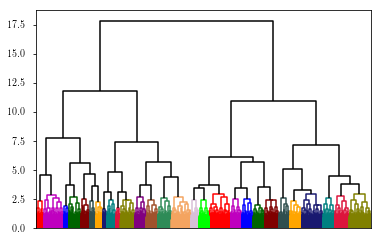

In [40]:
from scipy.cluster.hierarchy import cophenet
from scipy.spatial.distance import pdist

#print(cluster[-4:,2])
fig=plt.figure()
scipy.cluster.hierarchy.set_link_color_palette(['r','m','b','darkgreen','maroon','darkslategrey','orange','midnightblue','teal','crimson','olive','purple','sienna','seagreen','sandybrown','thistle','lime'])

sys.stdout=open('dend.txt','wt')
np.set_printoptions(threshold=np.inf)

#plt.title('Clusters')
_ = scipy.cluster.hierarchy.dendrogram(cluster, color_threshold = 3, no_labels=True, leaf_font_size= 1, count_sort='descendent', above_threshold_color='black')
plt.show()
fig.savefig('dendrogram_calpha.pdf')
print(_)

In [4]:
import sys
import numpy as np

sys.stdout = open('cluster_ID.txt', 'wt')

np.set_printoptions(threshold=np.inf)

from scipy.cluster.hierarchy import fcluster

max_d = 3.0

clusters = fcluster(cluster,max_d,criterion='distance')

print(clusters)
mapping = defaultdict(lambda : [])
for i, label in enumerate(clusters):
    mapping[label].append(i)
    
mapping

NameError: name 'cluster' is not defined

In [18]:
from scipy.cluster.hierarchy import leaders

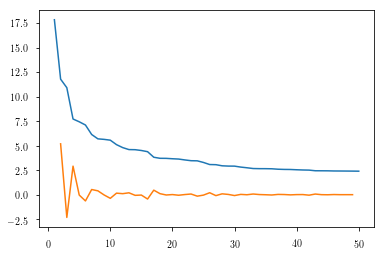

2

In [26]:
last = cluster[-50:, 2]
last_rev = last[::-1]
idxs = np.arange(1, len(last) + 1)
plt.plot(idxs, last_rev)

acceleration = np.diff(last, 2)  # 2nd derivative of the distances
acceleration_rev = acceleration[::-1]
plt.plot(idxs[:-2] + 1, acceleration_rev)
plt.show()
k = acceleration_rev.argmax() + 2  # if idx 0 is the max of this we want 2 clusters
k

In [6]:
from sklearn.cluster import AgglomerativeClustering 

In [53]:
hc = AgglomerativeClustering(n_clusters = 9, affinity = 'euclidean', linkage ='ward')


In [ ]:
y_hc=hc.fit(s)

In [ ]:
import sys

sys.stdout = open('cluster_ID_new.txt', 'wt')

np.set_printoptions(threshold=np.inf)
print(y_hc.labels_)

In [20]:
from sklearn.cluster import DBSCAN

In [46]:
db = DBSCAN(eps=6,min_samples=10)

In [47]:
y_db = db.fit(s)

/Users/dc42774/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:563: FutureWarning: Beginning in version 0.22, arrays of bytes/strings will be converted to decimal numbers if dtype='numeric'. It is recommended that you convert the array to a float dtype before using it in scikit-learn, for example by using your_array = your_array.astype(np.float64).
  FutureWarning)
/Users/dc42774/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:563: FutureWarning: Beginning in version 0.22, arrays of bytes/strings will be converted to decimal numbers if dtype='numeric'. It is recommended that you convert the array to a float dtype before using it in scikit-learn, for example by using your_array = your_array.astype(np.float64).
  FutureWarning)
/Users/dc42774/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:563: FutureWarning: Beginning in version 0.22, arrays of bytes/strings will be converted to decimal numbers if dtype='numeric'. It is recommended t

In [48]:
y_db.labels_

array([ 0,  0,  1, -1,  0,  0, -1, -1,  0,  1,  0,  0, -1, -1,  0, -1,  5,
        0,  0,  0, -1, -1, -1, -1,  0,  1,  0,  0, -1, -1, -1, -1,  0,  0,
        0,  0,  1, -1,  1,  1,  1,  1,  1,  0, -1,  3,  1,  0, -1,  3,  0,
        0, -1, -1, -1,  0,  1,  3, -1,  0, -1, -1,  0,  0, -1,  0, -1, -1,
        5,  0,  0,  0,  0,  0, -1,  2,  0, -1,  1, -1,  1,  0,  0,  0,  0,
        0,  0, -1, -1,  1, -1, -1,  1, -1, -1, -1,  0,  0,  3,  1,  0, -1,
        0,  0, -1,  1, -1,  1,  0,  0,  0,  0, -1,  1,  1, -1, -1, -1,  0,
        0,  0, -1,  0,  0, -1,  0, -1, -1, -1,  1,  1, -1, -1, -1,  0,  5,
       -1,  0,  0,  1, -1,  1,  3, -1,  1,  0,  0,  0, -1,  1,  0,  1, -1,
        1,  0, -1,  0, -1, -1, -1,  1, -1,  0,  0, -1, -1,  0,  0,  1,  0,
        1,  1,  1, -1,  0,  1,  1,  1,  1, -1,  0,  0, -1, -1,  1,  1,  0,
        0, -1,  0, -1, -1,  0, -1, -1, -1, -1,  0, -1, -1, -1,  1,  1, -1,
        1,  0, -1,  1, -1, -1,  1, -1,  1,  1,  0, -1, -1, -1,  1, -1, -1,
        0, -1, -1, -1,  1

In [32]:
from sklearn import metrics

In [1]:
metrics.calinski_harabaz_score(s,y_hc.labels_)

NameError: name 'metrics' is not defined

In [2]:
from sklearn.cluster import KMeans

In [17]:
with open("reformatted.txt") as textFile:
        s=[line.split() for line in textFile]
print(s)

In [18]:
s

[['0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.00000000',
  '0.000

In [12]:
sys.stdout = open('reformattednew.txt', 'wt')

np.set_printoptions(threshold=np.inf)
print(s)

In [13]:
from sklearn.cluster import KMeans

In [27]:
kmeans=KMeans(n_clusters=25, random_state=0).fit(s)

In [28]:
print(kmeans.labels_)

In [29]:
kmeans.labels_

array([ 0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  7,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  0,  1,  0,  1,  0,  1,  1,  1,  1,  1,  1,  0,  1,
        1, 13,  1,  1,  0,  1,  1,  0,  1,  7,  1,  0,  1,  1,  1,  0,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1, 23,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  0,
        1,  1,  1,  1,  1,  1,  1,  1,  0,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1, 24,  1,  1,  1,  1,  1,  1,  0,  1,  1,  1,  1,
        0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1, 10,  1,  1,  1,  0,  1,  1,  0,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  0,  0,  1, 22,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  0,  1,  1,  0,  1,  1,  0,  0,  1,  1, 12,  0,  1,
        1,  1,  1,  1,  1

In [30]:
kmeans.inertia_

0.0006873593867796023

In [33]:
metrics.calinski_harabaz_score(s,kmeans.labels_)

/Users/dc42774/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:563: FutureWarning: Beginning in version 0.22, arrays of bytes/strings will be converted to decimal numbers if dtype='numeric'. It is recommended that you convert the array to a float dtype before using it in scikit-learn, for example by using your_array = your_array.astype(np.float64).
  FutureWarning)


TypeError: cannot perform reduce with flexible type